In [1]:
# Let's read our character file
from sklearn.datasets import fetch_mldata
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
Handw_char = fetch_mldata('mnist original',target_name = 'digit',data_name = 'Handwirting')

In [2]:
# get some of the specifics of the dataset
X = Handw_char.data
y = Handw_char.target
n_samples, n_features = X.shape
h = w = 28
print("n_samples: {}".format(n_samples))
print("n_features: {}".format(n_features))
print("Original Image Sizes {} by {}".format(h, w))
print("Dimension of saved image is {}".format(1))
print (28*28) # the size of the images are the size of the feature vectors

n_samples: 70000
n_features: 784
Original Image Sizes 28 by 28
Dimension of saved image is 1
784


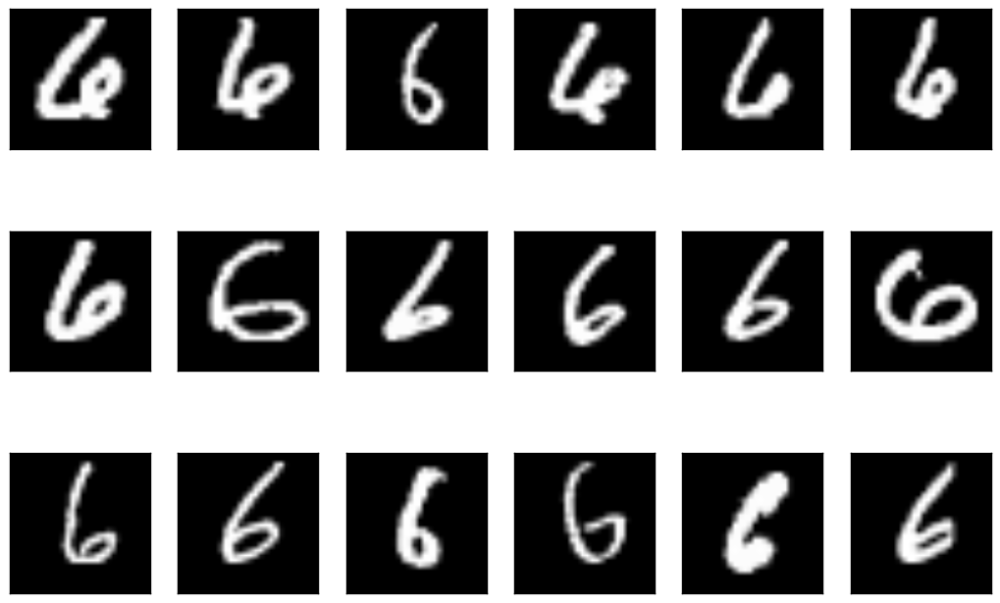

In [3]:
# a helper plotting function
def plot_gallery(images, h, w, n_row=3, n_col=6):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.7 * n_col, 2.3 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    Start = 40000
    Stop = n_row * n_col+Start
    Num = 1
    for i in np.arange(Start,Stop):
        plt.subplot(n_row, n_col, Num)
        Num = Num+1
        plt.imshow(images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.xticks(())
        plt.yticks(())

plot_gallery(X, h, w) # defaults to showing a 3 by 6 subset of the character

In [4]:
# lets do linear dimensionality reduction
# First we are going to try Full PCA
from sklearn.decomposition import PCA

n_components = 300
print ("Extracting the top %d eigenfaces from %d handwriting" % (
    n_components, X.shape[0]))

Fpca = PCA(n_components=n_components)
%time Fpca.fit(X)
eigenfaces = Fpca.components_.reshape((n_components, h, w))

Extracting the top 300 eigenfaces from 70000 handwriting
Wall time: 10.6 s


In [5]:
def plot_explained_variance(pca):
    import plotly
    from plotly.graph_objs import Scatter, Marker, Layout, XAxis, YAxis, Bar, Line
    plotly.offline.init_notebook_mode() # run at the start of every notebook
    
    explained_var = pca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)
    
    plotly.offline.iplot({
        "data": [Bar(y=explained_var, name='individual explained variance'),
                 Scatter(y=cum_var_exp, name='cumulative explained variance')
            ],
        "layout": Layout(xaxis=XAxis(title='Principal components'), yaxis=YAxis(title='Explained variance ratio'))
    })
      
plot_explained_variance(Fpca)
# From the plot we canfind that when principle component goes to 200, the explained variance ratio reaches 0.97 which is 
# enough for representing our image data. But in order to get better outcome, we will use 300 features in the latter part.

In [6]:
# let's do Randomized PCA 
from sklearn.decomposition import RandomizedPCA

n_components = 300
print ("Extracting the top %d eigenfaces from %d handwriting" % (
    n_components, X.shape[0]))

rpca = RandomizedPCA(n_components=n_components)
%time rpca.fit(X)
eigenfaces = rpca.components_.reshape((n_components, h, w))
# well, it's quicker than FULL-PCA

Extracting the top 300 eigenfaces from 70000 handwriting
Wall time: 9.33 s


In [7]:
# lets do non-linear dimensionality reduction
# Let's do Kernel PCA
X1 = X[40000:44000]
from sklearn.decomposition import KernelPCA
n_components = 300
print ("Extracting the top %d eigenfaces from %d faces" % (n_components, X1.shape[0]))

kpca = KernelPCA(n_components=n_components, kernel='poly', 
                fit_inverse_transform=True, gamma=19) # very sensitive to the gamma parameter
%time kpca.fit(X1)
# From our experiments, we find that if we use too much instances Kernel PCA becomes horriblly slow. And if we use the 
# whole dataset, our computer may even crash. So we only use 4000 instances here. 
# Correspondingly, in the later part we will choose data in [40000:44000] to do representation.

Extracting the top 300 eigenfaces from 4000 faces
Wall time: 12 s


KernelPCA(alpha=1.0, coef0=1, degree=3, eigen_solver='auto',
     fit_inverse_transform=True, gamma=19, kernel='poly',
     kernel_params=None, max_iter=None, n_components=300,
     remove_zero_eig=False, tol=0)

In [8]:
import warnings
warnings.simplefilter('ignore', DeprecationWarning)

from ipywidgets import widgets  # make this interactive!
# compare the different methods

def plt_reconstruct(idx_to_reconstruct):
    idx_to_reconstruct = np.round(idx_to_reconstruct)
    
    reconstructed_image = Fpca.inverse_transform(Fpca.transform(X[idx_to_reconstruct]))
    reconstructed_image_rpca = rpca.inverse_transform(rpca.transform(X[idx_to_reconstruct]))
    reconstructed_image_kpca = kpca.inverse_transform(kpca.transform(X[idx_to_reconstruct]))
    
    
    plt.figure(figsize=(15,7))
    
    plt.subplot(1,4,1)
    plt.imshow(X[idx_to_reconstruct].reshape((h, w)), cmap=plt.cm.gray)
    plt.title("Original Picture")
    plt.grid()
    
    plt.subplot(1,4,2)
    plt.imshow(reconstructed_image.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Full PCA')
    plt.grid()
    
    plt.subplot(1,4,3)
    plt.imshow(reconstructed_image_rpca.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Randomized PCA')
    plt.grid()
    
    plt.subplot(1,4,4)
    plt.imshow(reconstructed_image_kpca.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Kernel PCA')
    plt.grid()
    
widgets.interact(plt_reconstruct,idx_to_reconstruct=(40000,44000,1),__manual=True)

<function __main__.plt_reconstruct>

From the pictures above we can find Kernel PCA has a better preformance than Full PCA and Randomize PCA which means for our dataset non-linear dimensionality reduction has better outcome than linear dimensionality reduction. But we have to admit that Kernel PCA is really slow when it comes to a dataset with tons of instances just like ours. So in our experiment, if we want a better reconstruction for several image non-linear is better, while if we want do dimensionality reduction to the whole dataset then linear dimensionality reduction is a better choice. Besides, difference between linear method and non-linear method is very 
small. So for me I will choose linear dimensionality reduction.

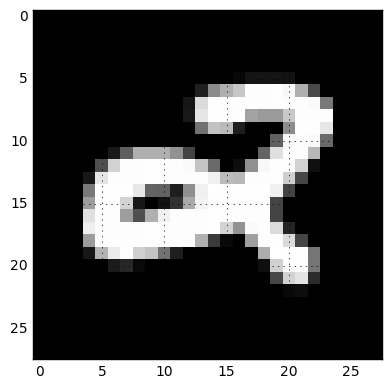

In [9]:
# let's extract Image Feature by calculating gradients
from skimage.io import imshow

idx_to_reconstruct = int(np.random.rand(1)*len(X))
img  = X[idx_to_reconstruct].reshape((h,w))
imshow(img)
plt.grid()

C:\Users\gaoha\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:77: UserWarning:

Float image out of standard range; displaying image with stretched contrast.



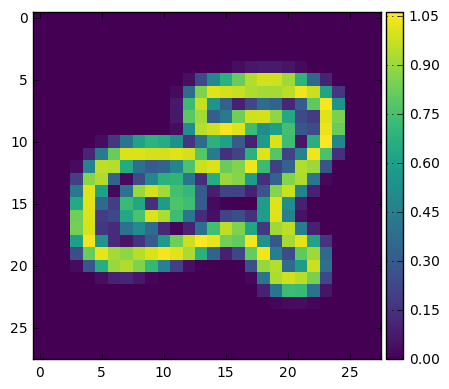

In [10]:
from skimage.filters import sobel_h, sobel_v

gradient_mag = np.sqrt(sobel_v(img)**2 + sobel_h(img)**2 ) 
imshow(gradient_mag)
plt.grid()

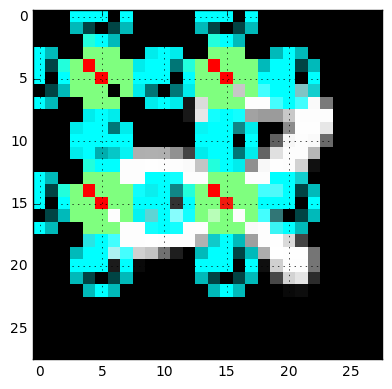

In [11]:
# Let's try DAISY Bag of Features Model
from skimage.feature import daisy

# lets first visualize what the daisy descripto looks like
features, img_desc = daisy(img,step=10, radius=5, rings=2, histograms=4, orientations=6, visualize=True)
imshow(img_desc)
plt.grid()

In [12]:
# create a function to tak in the row of the matric and return a new feature
def apply_daisy(row,shape):
    feat = daisy(row.reshape(shape),step=5, radius=5, rings=2, histograms=6, orientations=8, visualize=False)
    return feat.reshape((-1))

%time test_feature = apply_daisy(X[3],(h,w))
test_feature.shape

Wall time: 3.51 ms


(1664,)

In [13]:
# apply to part of data, row by row,
# takes about a minute to run
Tx = X[0:5000]
%time daisy_features = np.apply_along_axis(apply_daisy, 1, Tx, (h,w))
print(daisy_features.shape)

Wall time: 11.2 s
(5000, 1664)


In [14]:
from sklearn.metrics.pairwise import pairwise_distances
# find the pairwise distance between all the different image features
%time dist_matrix = pairwise_distances(daisy_features)

Wall time: 976 ms


In [15]:
from ipywidgets import fixed
import copy
# put it together inside a nice widget
def closest_image(dmat,idx1):
    distances = copy.deepcopy(dmat[idx1,:]) # get all image diatances
    distances[idx1] = np.infty # dont pick the same image!
    idx2 = np.argmin(distances)
    
    distances[idx2] = np.infty
    idx3 = np.argmin(distances)
    
    plt.figure(figsize=(10,16))
    plt.subplot(1,3,1)
    imshow(X[idx1].reshape((h,w)))
    plt.title("Original Image ")
    plt.grid()

    plt.subplot(1,3,2)
    imshow(X[idx2].reshape((h,w)))
    plt.title("Closest Image  ")
    plt.grid()
    
    plt.subplot(1,3,3)
    imshow(X[idx3].reshape((h,w)))
    plt.title("Next Closest Image ")
    plt.grid()
    
widgets.interact(closest_image,idx1=(0,5000,1),dmat=fixed(dist_matrix),__manual=True)
# This is very useful. With feature extraction, we can not only do handwriting recognation, but also writer recogonation 
# which is very useful in our daliy life. Moreover, for a specific writer we can use our data to perdict his handwriting of 
# other characters. In a word, Feature extraction perfectly suits our dataset.

C:\Users\gaoha\Anaconda3\lib\site-packages\traitlets\traitlets.py:565: FutureWarning:

comparison to `None` will result in an elementwise object comparison in the future.



<function __main__.closest_image>

In [16]:
# Let's calculate pairwise differences among part of instances
# As we have too many instance, so we will use part of them
# Here we compare different '0'
Px0 = X[0:50]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d = pairwise_distances(Px0)

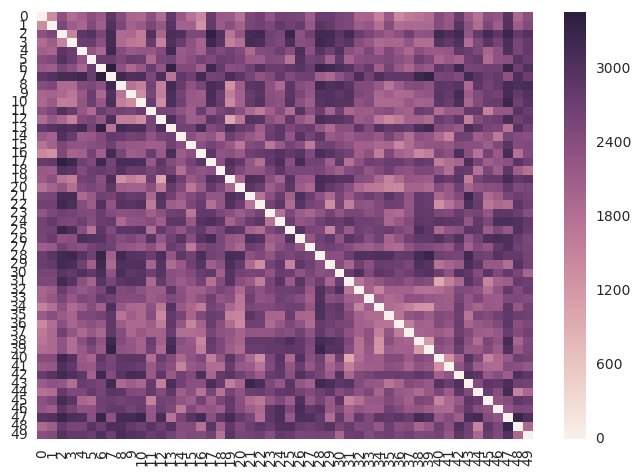

In [17]:
import seaborn as sns
ax =sns.heatmap(Pair_d)

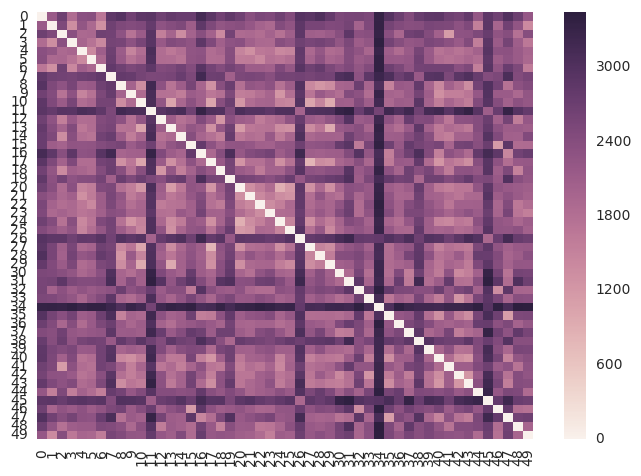

In [52]:
# Let's see character '6' (similar with '9')
Px7 = X[40000:40050]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d7 = pairwise_distances(Px7)
ax =sns.heatmap(Pair_d7)

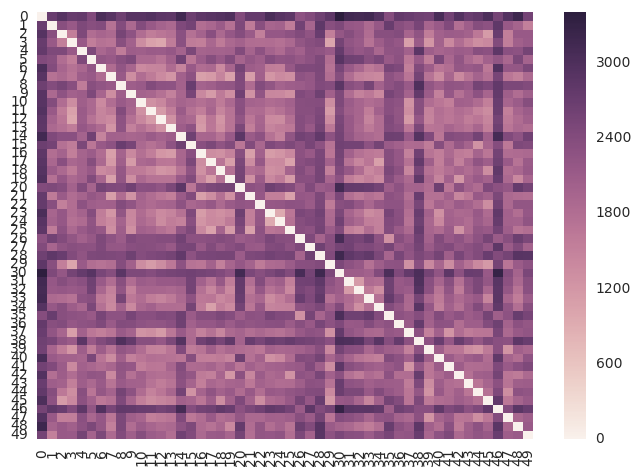

In [18]:
# Let's see character '7'
Px7 = X[45000:45050]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d7 = pairwise_distances(Px7)
ax =sns.heatmap(Pair_d7)

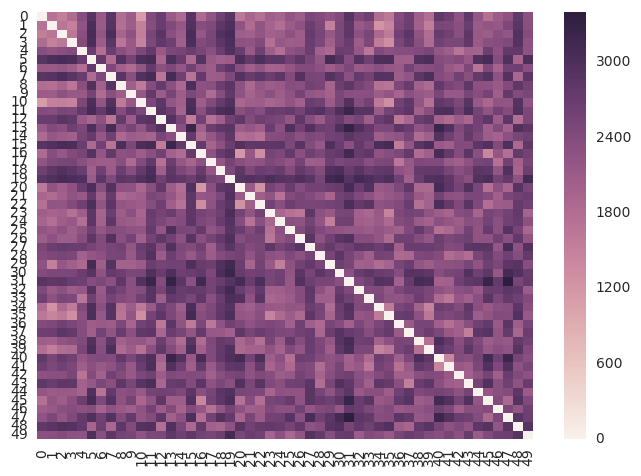

In [19]:
# Let's see character '5'
Px5 = X[35000:35050]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d5 = pairwise_distances(Px5)
ax =sns.heatmap(Pair_d5)

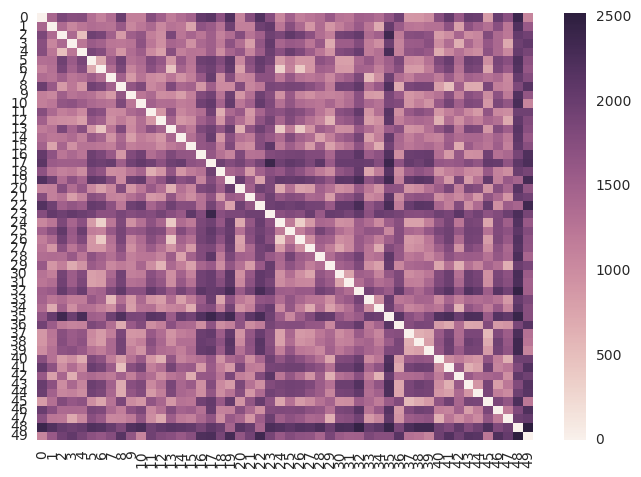

In [20]:
# Let's see character '1'
Px5 = X[11000:11050]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d5 = pairwise_distances(Px5)
ax =sns.heatmap(Pair_d5)

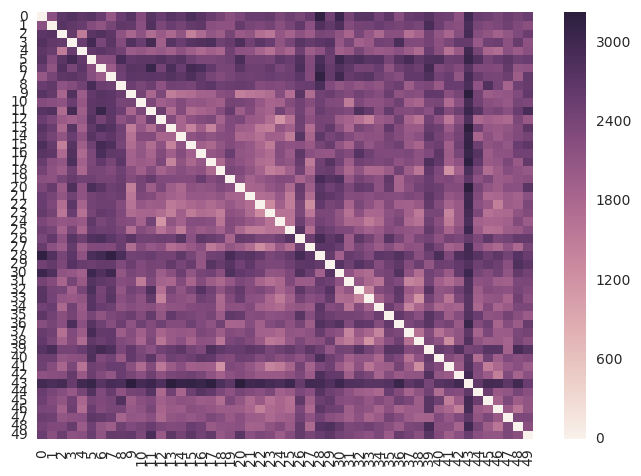

In [21]:
# Let's see character '8'
Px8 = X[51000:51050]
from sklearn.metrics.pairwise import pairwise_distances
Pair_d8 = pairwise_distances(Px8)
ax =sns.heatmap(Pair_d8)

Well, we have compared same characters (0,1,5,6,7,8) written by different people. Sure enough, '1' has the smallest differences among our instances. '8' and '5' have the largest differences. What makes us impressed is '0'. We used to think '0' may just like character '1'. But it doesn't which means for different people '0' has different writings. So if we want to use our dataset to do writer recogonition, '5','0' and '8' are good choice. But if we are going to do handwriting recogonition, well we may need bigger training data for these characters like '5' and we can use smaller training set for characters like '1' and '7'.

In [23]:
# Let's use biplots to describe any natural clusters in the dataset.
row, _= X.shape
Ava = [None] * row
for index in range(row):
    Ava[index] = np.mean(X[index])

In [51]:
def biplot(pca, dat, title=''):
    
    import plotly
    from plotly.graph_objs import Scatter, Marker, Layout, XAxis, YAxis, Bar, Line
    plotly.offline.init_notebook_mode() # run at the start of every notebook
    
    # 0,1 denote PC1 and PC2; change values for other PCs
    xvector = pca.components_[0] 
    yvector = pca.components_[1]

    tmp = pca.transform(dat)
    xs = tmp[:,0] 
    ys = tmp[:,1]

    annotations = [Scatter(x=xs, y=ys, mode ='markers', name='cumulative explained variance')]
    for i in range(len(xvector)):
        txt = list(dat)[i]
        annotations.append(
                Scatter(
                    x=[0, xvector[i]*max(xs)],
                    y=[0, yvector[i]*max(ys)],
                    mode='lines+text',
                    text=['', txt],
                    name=txt,
                ))
    
    plotly.offline.iplot({
        "data": annotations,
        "layout": Layout(xaxis=XAxis(title='Principal Component One'), 
                         yaxis=YAxis(title='Principal Component Two'),
                        title=title)
    })


    plt.show()

Px = X[40000:44000]
pca = PCA(n_components=n_components)
X_pca = pca.fit(Px)
biplot(pca,Px,'Handwriting Character Biplot')

As we have too much instances, in this part we only choose 4000 instances including 2000 '6' samples and 2000 '7' samples. We can clearly see two clusters from the plot above. The left cluster is much closer than the right one. But why? From the former analysis  we know that '6' has larger pairwise differences than '7'. Maybe that is the answer for our question. This outcome has further proved our conclusion that different characters have different similarity among instances. So we have to use them wisely. 